In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

Cloning into 'yolov5'...
remote: Enumerating objects: 16016, done.
remote: Counting objects: 100% (8/8), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 16016 (delta 1), reused 2 (delta 0), pack-reused 16008
Receiving objects: 100% (16016/16016), 14.53 MiB | 26.33 MiB/s, done.
Resolving deltas: 100% (11013/11013), done.
/kaggle/working/yolov5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
opentelemetry-api 1.17.0 requires importlib-metadata~=6.0.0, but you have importlib-metadata 5.2.0 which is incompatible.
pymc3 3.11.5 requires numpy<1.22.2,>=1.15.0, but you have numpy 1.23.5 which is incompatible.
pymc3 3.11.5 requires scipy<1.8.0,>=1.7.3, but you have scipy 1.10.1 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


In [2]:
!pip install roboflow
from roboflow import Roboflow
rf = Roboflow(api_key="TTomT1aGY4q5TZoyuhFN")
project = rf.workspace("demarcationbased-road-lane-segmentation").project("road-lane-instance-segmentation")
dataset = project.version(2).download("yolov5")


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.6/55.6 kB 5.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9657 sha256=0ebc6880f1885a92a836294d6a646707c96a5c1f04210acb62ca04ddcc2e2ea3
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
    Uninstalling pyparsing-3.0.9:
      Successfully uninstalled pyparsing-3.0.9
  Attempting uninstall: idna
    Found 

Extracting Dataset Version Zip to Road-Lane-Instance-Segmentation-2 in yolov5pytorch:: 100%|██████████| 10808/10808 [00:03<00:00, 3574.76it/s]


In [3]:
logger = 'Comet' #@param ['ClearML', 'Comet', 'TensorBoard']

if logger == 'ClearML':
    %pip install -q clearml
    import clearml; clearml.browser_login()
elif logger == 'Comet':
    %pip install -q comet_ml
    import comet_ml; comet_ml.init()
elif logger == 'TensorBoard':
    %load_ext tensorboard
    %tensorboard --logdir runs/train

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jupyterlab-lsp 4.2.0 requires jupyter-lsp>=2.0.0, but you have jupyter-lsp 1.5.1 which is incompatible.
Note: you may need to restart the kernel to use updated packages.
Please paste your Comet API key from https://www.comet.com/api/my/settings/
(api key may not show as you type)


Comet API key:  ·························


COMET INFO: Valid Comet API Key saved in /root/.comet.config (set COMET_CONFIG to change where it is saved).


In [4]:
%cat {dataset.location}/data.yaml

names:
- Road Lane
nc: 1
roboflow:
  license: CC BY 4.0
  project: road-lane-instance-segmentation
  url: https://universe.roboflow.com/demarcationbased-road-lane-segmentation/road-lane-instance-segmentation/dataset/2
  version: 2
  workspace: demarcationbased-road-lane-segmentation
test: ../test/images
train: Road-Lane-Instance-Segmentation-2/train/images
val: Road-Lane-Instance-Segmentation-2/valid/images


In [5]:
import yaml
with open(dataset.location + "/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [6]:
%cat /kaggle/working/yolov5/models/segment/yolov5s-seg.yaml

# YOLOv5 🚀 by Ultralytics, AGPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.5  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [7]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [8]:
%%writetemplate models/custom_yolov5s-seg.yaml

# Custom YOLOv5 segmentation parameters for road lane detection

# Parameters
nc: {num_classes}# number of classes (1 class for road lane detection)
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.5  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Segment, [nc, anchors, 32, 256]],  # Detect(P3, P4, P5)
  ]


In [ ]:
# pip install clearml

In [10]:
%cd /kaggle/working/yolov5/
# !python train.py --img 416 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache
!python3 segment/train.py --img 640 --batch-size 32 --epochs 20 --data {dataset.location}/data.yaml  --cfg ./models/custom_yolov5s-seg.yaml --weights '' --name yolov5s_seg_results  --cache

/kaggle/working/yolov5
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 
wandb: W&B disabled due to login timeout.
segment/train: weights=, cfg=./models/custom_yolov5s-seg.yaml, data=/kaggle/working/yolov5/Road-Lane-Instance-Segmentation-2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=20, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train-seg, name=yolov5s_seg_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, ma

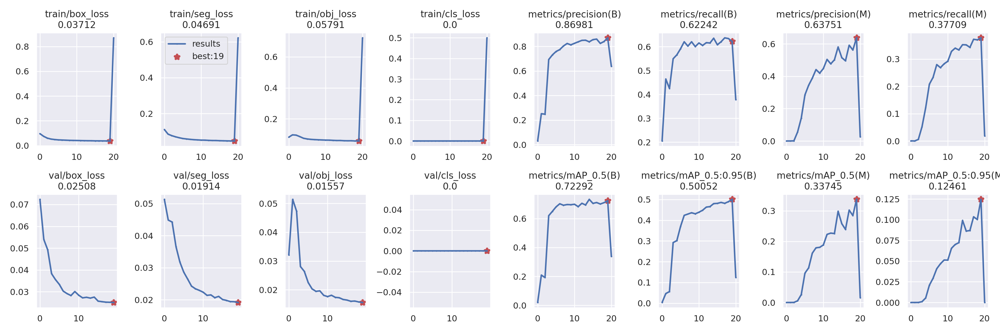

In [11]:
from IPython.display import Image, clear_output
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/kaggle/working/yolov5/runs/train-seg/yolov5s_seg_results2/results.png', width=1000) 

GROUND TRUTH TRAINING DATA:


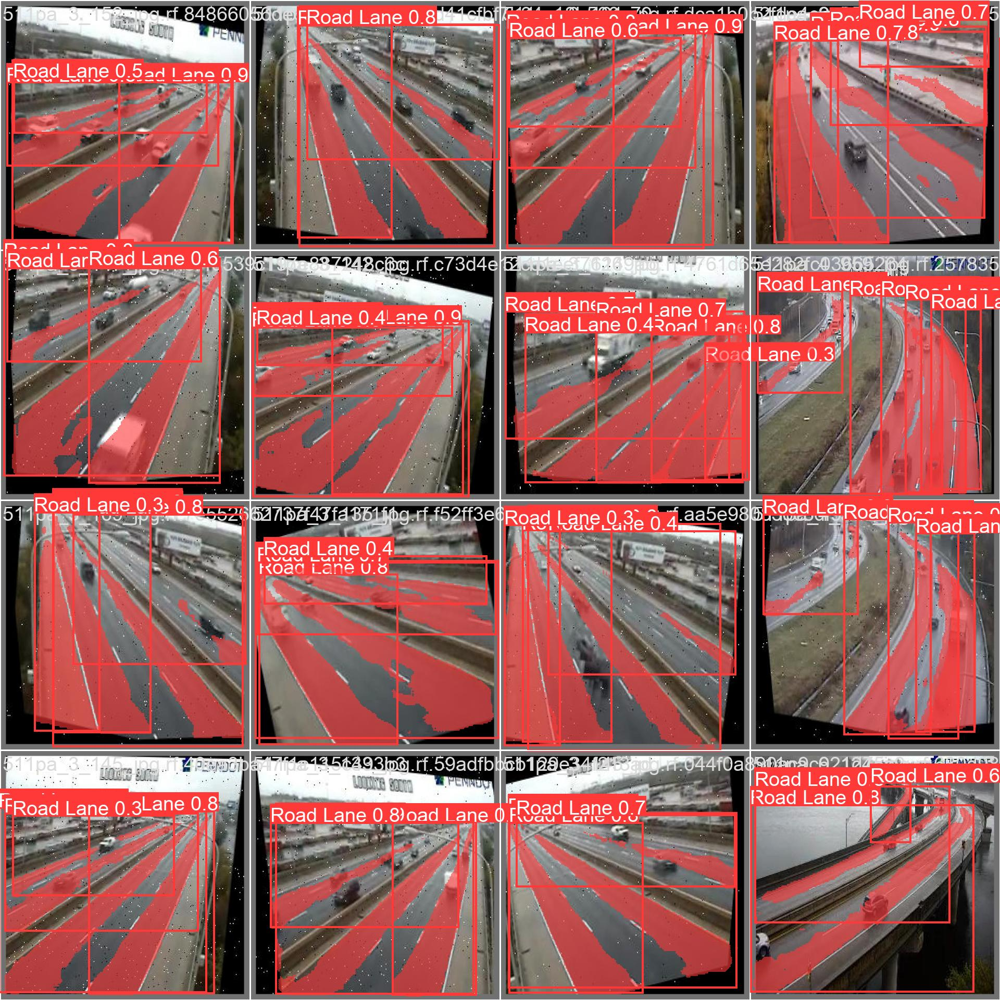

In [12]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/kaggle/working/yolov5/runs/train-seg/yolov5s_seg_results2/val_batch1_pred.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


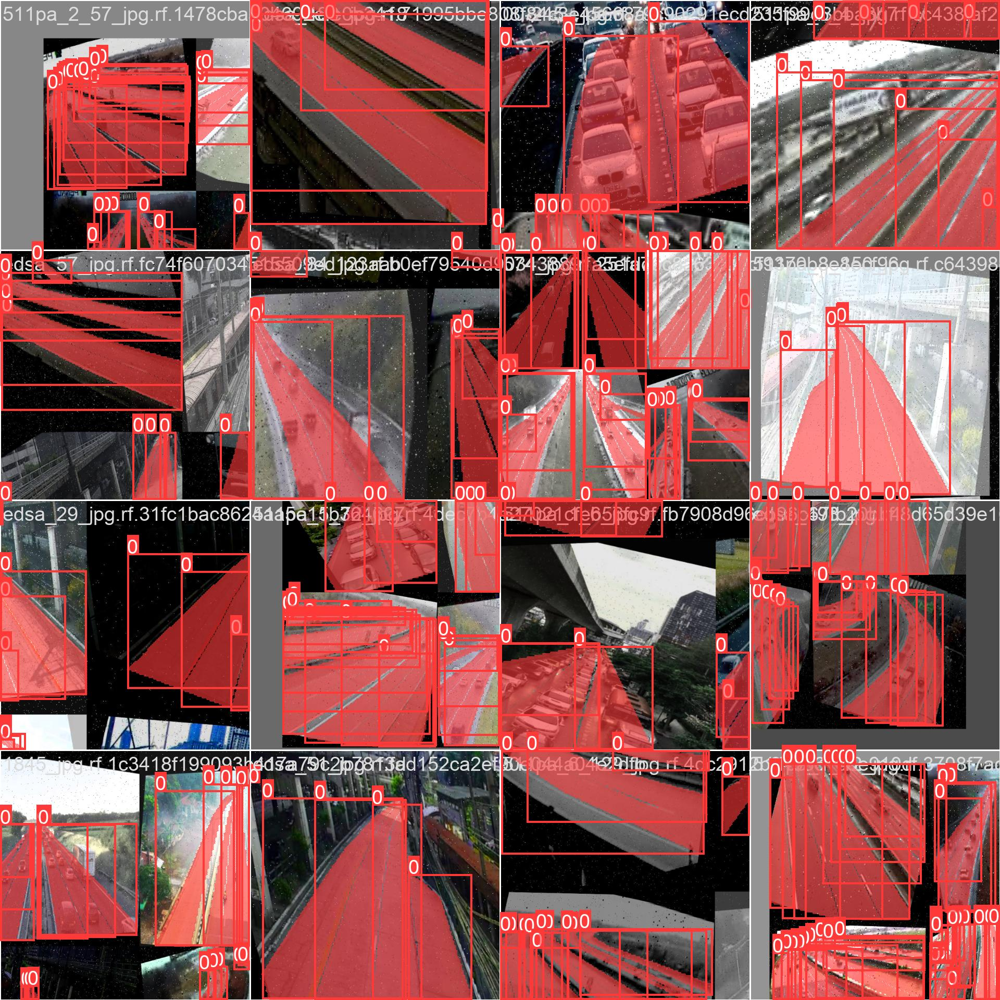

In [13]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/kaggle/working/yolov5/runs/train-seg/yolov5s_seg_results2/train_batch0.jpg', width=900)

In [14]:
%ls /kaggle/working/yolov5/runs/train-seg/yolov5s_seg_results2/weights

best.pt  last.pt


In [15]:
%cd /kaggle/working/yolov5/
!python segment/predict.py --weights runs/train-seg/yolov5s_seg_results2/weights/best.pt --conf 0.4 --source Road-Lane-Instance-Segmentation-2/test/images

/kaggle/working/yolov5
segment/predict: weights=['runs/train-seg/yolov5s_seg_results2/weights/best.pt'], source=Road-Lane-Instance-Segmentation-2/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/predict-seg, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1, retina_masks=False
YOLOv5 🚀 v7.0-189-ga453a45 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
custom_YOLOv5s-seg summary: 165 layers, 7398422 parameters, 0 gradients, 25.7 GFLOPs
image 1/104 /kaggle/working/yolov5/Road-Lane-Instance-Segmentation-2/test/images/00-237-_jpg.rf.5862ce3abda428c4f1a8162fa974115f.jpg: 640x640 3 Road Lanes, 7.3ms
image 2/104 /kaggle/working/yolov5/Road-Lane-Instance-Segmenta

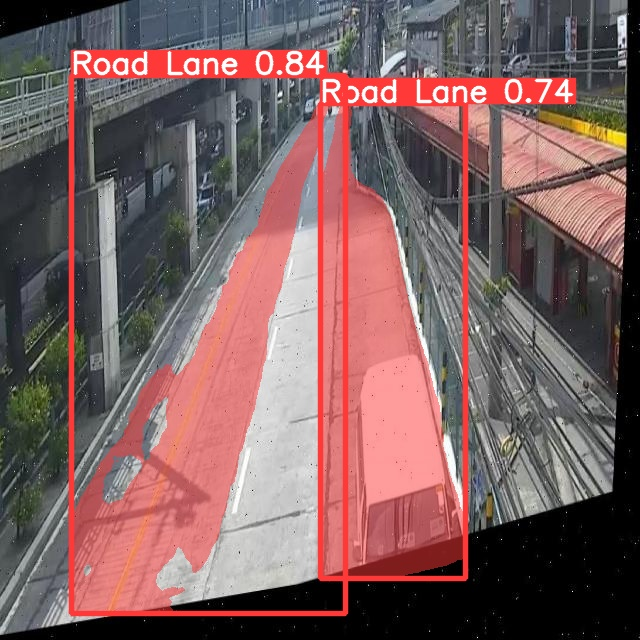

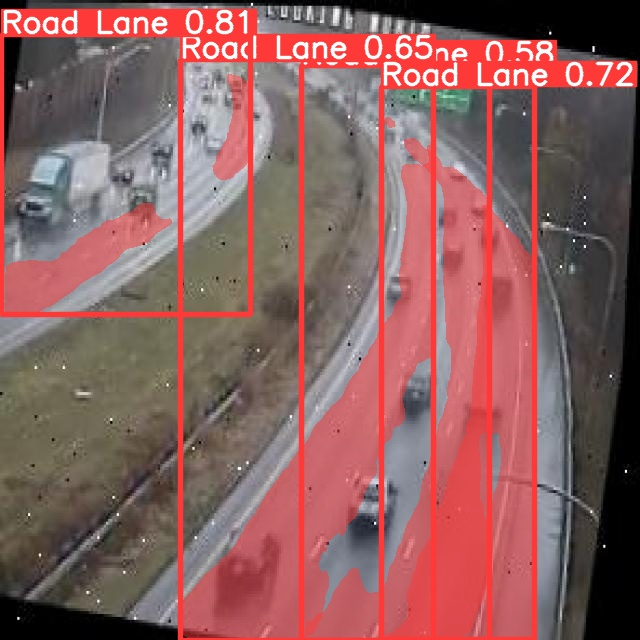

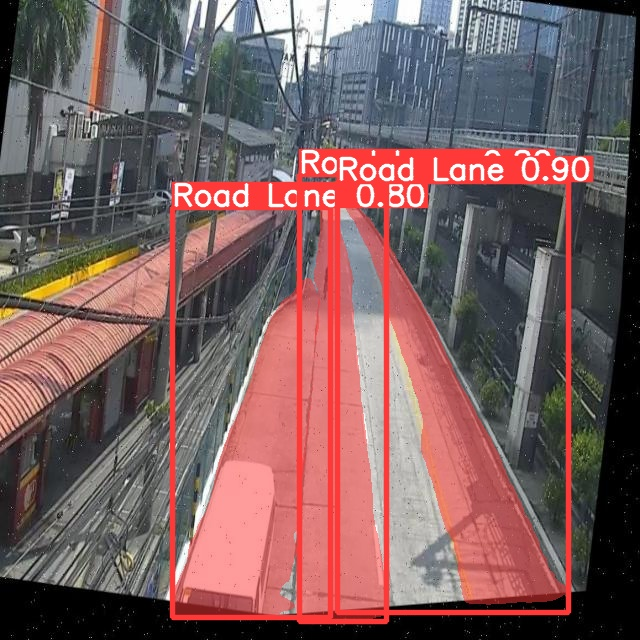

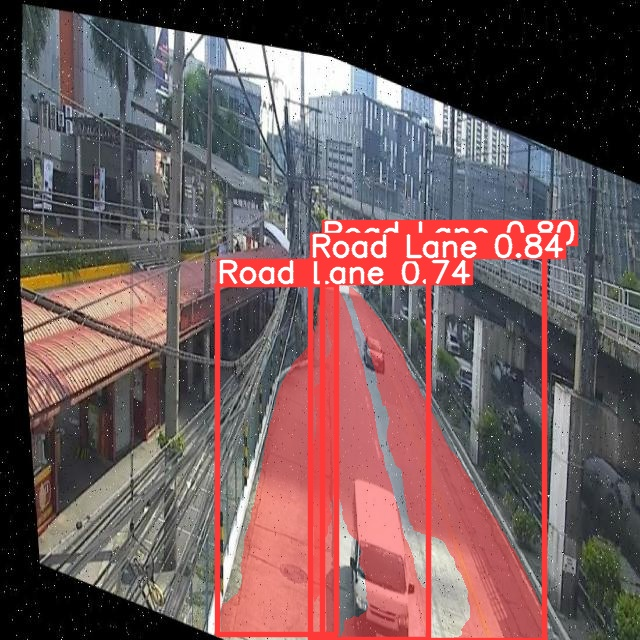

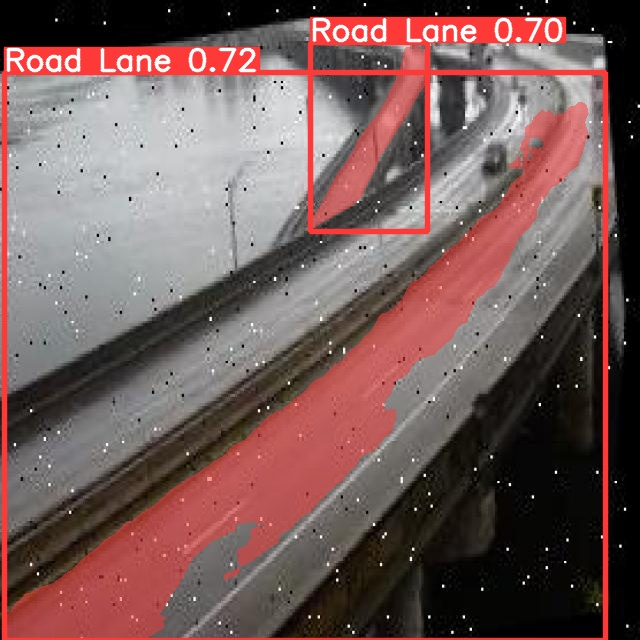

...

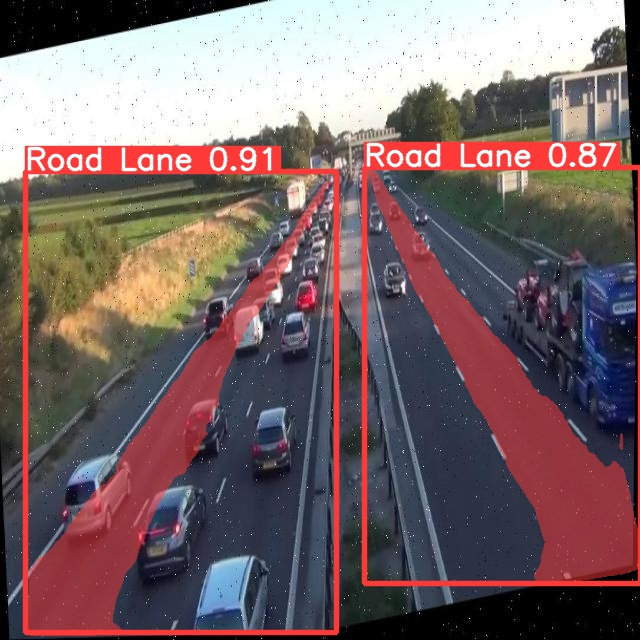

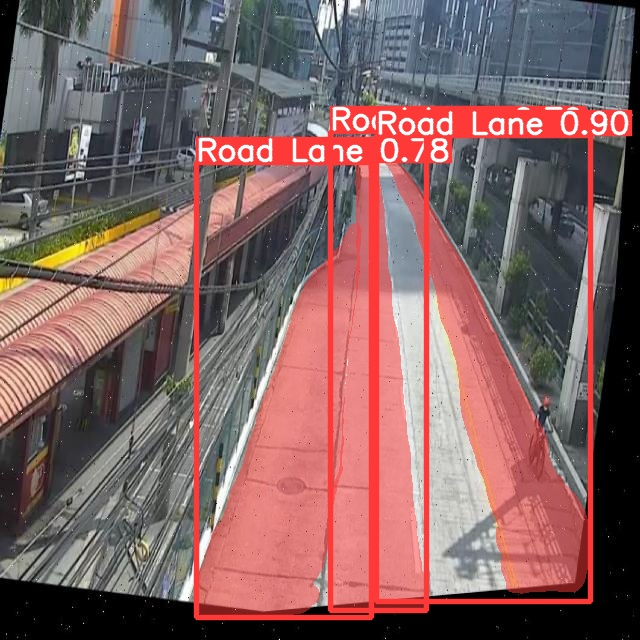

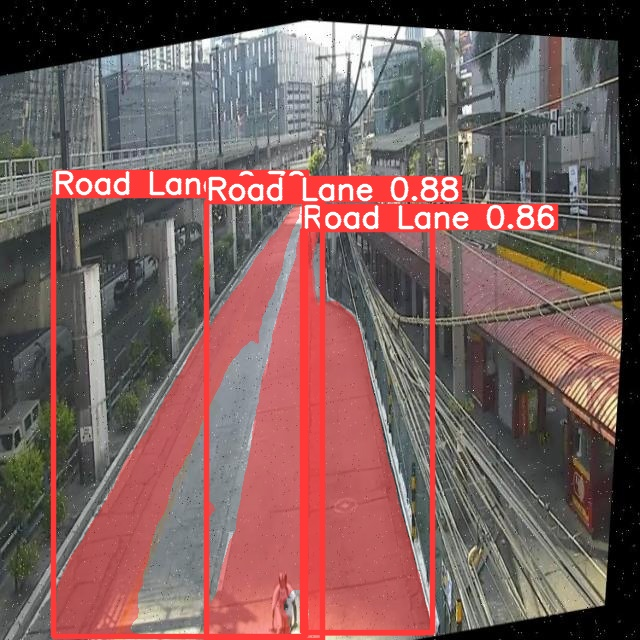

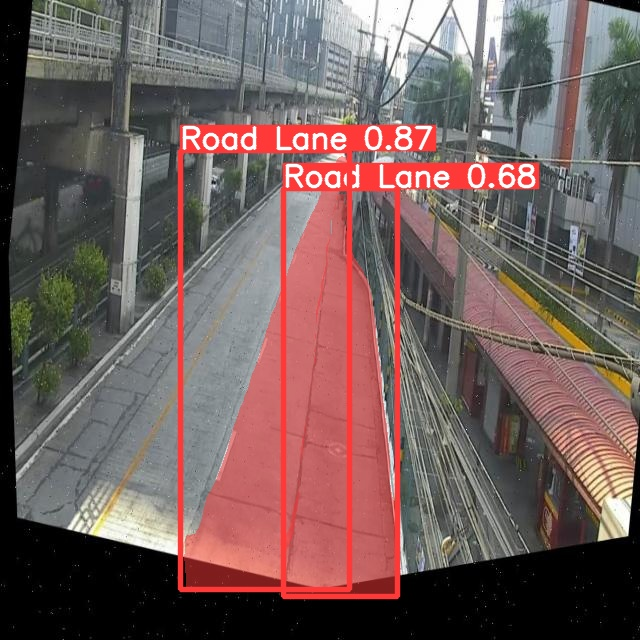

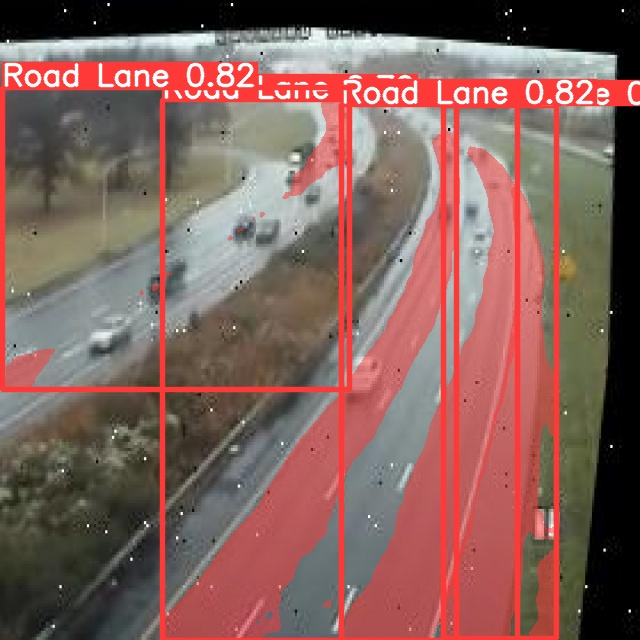

In [17]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('runs/predict-seg/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
%cp /kaggle/working/yolov5/runs/train-seg/yolov5s_seg_results2/weights/best.pt /kaggle/working/